## MLOPs Final Project

### Hotel Booking Demand Analysis

#### Dataset: Kaggle (link: https://www.kaggle.com/jessemostipak/hotel-booking-demand) 
#### No. of features = 32, No. of records = 119390

# Section 1: Data Preparation

Essential installations

In [ ]:
# Installing libraries
!pip install fast_ml
!pip install --upgrade wandb==0.9.7
!pip install category_encoders
!pip install pyarrow
!pip install fastparquet
!pip install evidently
!pip install pyyaml==5.4.1
!pip uninstall pandas-profiling
!pip install pandas-profiling[notebook,html]
!pip install eli5
!pip install scikit-learn==1.0
!pip install --upgrade sklearn

In [ ]:
# Loading libraries
import sys
!{sys.executable} -m pip install -U pandas-profiling[notebook]
!jupyter nbextension enable --py widgetsnbextension

import pandas as pd
import os
from fast_ml.model_development import train_valid_test_split
import pandas_profiling
from pandas_profiling import ProfileReport
from category_encoders import OneHotEncoder, TargetEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score
import xgboost as xgb
import wandb
import os
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from evidently.dashboard import Dashboard
from evidently.tabs import DataDriftTab, CatTargetDriftTab
from evidently.model_profile import Profile
from evidently.profile_sections import DataDriftProfileSection, CatTargetDriftProfileSection
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sn
import warnings
warnings.filterwarnings('ignore')
from sklearn.metrics import RocCurveDisplay
from sklearn.inspection import PartialDependenceDisplay


In [36]:
# Loading dataset
%%time
df_main = pd.read_csv("https://drive.google.com/uc?export=download&id=1WYkjWlOCah0u2KugcyoGPGNuBkZYsAWB")

CPU times: user 325 ms, sys: 37.9 ms, total: 363 ms
Wall time: 2.55 s


In [4]:
df_main.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [33]:
# Finding dimensions of the dataset
df_main.shape

(119390, 32)

In [6]:
df_main.head(5)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


#### Data Profiling

In [7]:
profile = ProfileReport(df_main, title = 'Hotel Booking Data Profiling Report')
profile.to_notebook_iframe()
profile.to_file("hotelbooking_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

#### Data Wranging 

In [37]:
# Creating a new column
df_main['is_alloted_same_room_type'] = np.where(df_main['reserved_room_type'] == df_main['assigned_room_type'] , 1, 0)

In [38]:
## Removing irrelavent columns & columns with NAs

df_main = df_main.drop('reservation_status', 1)
df_main = df_main.drop('reservation_status_date', 1)
df_main = df_main.drop('arrival_date_year', 1)
df_main = df_main.drop('arrival_date_day_of_month', 1)
df_main = df_main.drop('agent', 1)
df_main = df_main.drop('company', 1)
df_main = df_main.drop('reserved_room_type', 1)
df_main = df_main.drop('assigned_room_type', 1)

df_main = df_main[df_main['children'].notna()]

# Section 2: Model Development: Model Building and Experiment Tracking

## Identifying numerical and categorical features

In [39]:
x_columns = list(df_main.columns)
x_columns.remove('is_canceled')
df_main = df_main[x_columns + ['is_canceled']]
cat_features = ['hotel', 'arrival_date_month','arrival_date_week_number','meal','country','market_segment','distribution_channel',
                'is_alloted_same_room_type','deposit_type','customer_type','is_repeated_guest']

num_features = list(set(x_columns) - set(cat_features))

## Utility method for preparing the data

- Splitting the dataset
- Encoding Catgorical Variables

In [40]:
def prepare_data(X,
                 y,
#                 num_scaler = None,
#                 num_imputer = None,
#                 cat_imputer = None,
                 num_features,
                 cat_features,
                 train_size = 0.8,
                 seed = 100,
                 cat_encoder = None):
  
  # Split the dataset into train and test split
  x_train, y_train, x_valid, y_valid, x_test, y_test = train_valid_test_split(df_main, target="is_canceled",
                                                                            train_size=0.6, valid_size=0.2, test_size=0.2)
  
  # encoder the categorical features
  cat_encoder.fit(X=x_train, y=y_train)
  x_train_encoded = cat_encoder.transform(x_train)
  x_test_encoded = cat_encoder.transform(x_test)
  x_valid_encoded = cat_encoder.transform(x_valid)

  return x_train_encoded, x_test_encoded, x_valid_encoded, y_train, y_test, y_valid
  

**Defining function to Run Model Experiments & Initializing Weights & Biases**

In [41]:
os.environ["WANDB_API_KEY"] = "ec91b9934bdaaa32178d09be4e69afd032dfb23e"

In [42]:
def run_model_experiment(model,
                         x_train,
                         y_train,
                         x_test,
                         y_test,
                         name,
                         config = None,
                         tags = None):
  
  model.fit(x_train, y_train)

  wandb.init(project='hotel_bookings_final_draft', config=config, tags = tags)
  wandb.run.name = name
  acc = accuracy_score(y_test, model.predict(x_test))
  f1 = f1_score(y_test, model.predict(x_test))

  wandb.log( {"accuracy" : acc, 
              "f1_score": f1} )
  
  wandb.Artifact(name, 
                 type = 'model',
                 description = config)

  wandb.save("model.h5")
  #wandb.finish()

  return model

**Splitting the Data and Encoding Categorical features (OHE and TE)**

In [43]:
ohe_encoder = OneHotEncoder(cols = cat_features, use_cat_names = True)
target_encoder = TargetEncoder(cols = cat_features)

x_train, x_test, x_valid, y_train, y_test, y_valid = prepare_data(df_main[x_columns],
                                                df_main.is_canceled,
                                                cat_encoder = ohe_encoder,
                                                num_features = num_features,
                                                cat_features = cat_features)

x_train.columns = x_train.columns.str.replace(" ","")
x_test.columns = x_test.columns.str.replace(" ","")

x_train_n = x_train.to_numpy()
y_train_n = y_train.to_numpy()
x_test_n = x_test.to_numpy()
y_test_n = y_test.to_numpy()

## Predictive Models

### 1.  Baseline Model: Logistic Regression w/ OHE

In [45]:
logistic_reg_model = LogisticRegression()  
logModel_model = run_model_experiment(logistic_reg_model, x_train, y_train, x_test, y_test, 
                                   name = 'LogisticRegressionWithOHE', tags = ['Logistic Regression', 'baseline', 'OheEncoder'])

wandb: Wandb version 0.12.7 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


### 2. Random Forest w/ OHE

In [46]:
params = { "n_estimators": 100,
           "max_depth": 10,
           "max_features": .2,
           "max_samples": 0.4 }

rf_model = RandomForestClassifier(**params)
rf_model = run_model_experiment(rf_model,  x_train, y_train, x_test, y_test, config = params, 
                                name = 'RFwithOHE', tags = ['RF', 'OheEncoding'])

wandb: Wandb version 0.12.7 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


### 3. RandomForest with Target Encoding

In [47]:
params = { "n_estimators": 100,
           "max_depth": 10,
           "max_features": .2,
           "max_samples": 0.4 }

rf_model = RandomForestClassifier(**params)  
rf_model = run_model_experiment(rf_model,  x_train, y_train, x_test, y_test, config = params, 
                                name = 'RFwithTargetEncoding', tags = ['RF', 'TargetEncoding'])

wandb: Wandb version 0.12.7 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


### 4. Gradient Boosted Trees

In [48]:
params = { "n_estimators": 100,
           "max_depth": 4 }

gbm_model = GradientBoostingClassifier(**params)  
gbm_model = run_model_experiment(gbm_model,  x_train, y_train, x_test, y_test, config = params, 
                                 name = 'GBMwithTargetEncoding', tags = ['GBM', 'TargetEncoding'])

wandb: Wandb version 0.12.7 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


### 5. XGB Model

In [50]:
params = { "n_estimators": 200,
           "max_depth": 6}

xgb_classifier = xgb.XGBClassifier(**params)

wandb.init(project='hotel_bookings_final_draft', config=params, tags = ['XGB', 'TargetEncoding'])

model_fit = xgb_classifier.fit(x_train, y_train, callbacks=[wandb.xgboost.wandb_callback()])
wandb.run.name = "XGBWithTargetEncoding"

acc = accuracy_score(y_test, xgb_classifier.predict(x_test))
f1 = f1_score(y_test, xgb_classifier.predict(x_test))
wandb.log( {"accuracy" : acc, "f1_score": f1} )
wandb.save("model.h5")


wandb: Wandb version 0.12.7 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


[]

## Get Experiment Details

In [ ]:
api = wandb.Api()

all_runs = api.runs("atul_yerra/hotel_bookings_final", order="+summary_metrics.f1_score")

for run in all_runs:
  print(f"Model Name: {run.name} and F1Score {run.summary.get('f1')}")
  print(run.config)

## Creating Model Pipeline

In [52]:
numeric_transformer_a = Pipeline(steps=[('scaler', StandardScaler())])
categorical_transformer_ohe_a = Pipeline(steps=[('onehot', OneHotEncoder(handle_unknown='ignore'))])
categorical_transformer_te_a = Pipeline(steps=[('tarenc', TargetEncoder(handle_unknown='ignore'))])

preprocessor_ohe_a = ColumnTransformer(transformers=[('num', numeric_transformer_a, num_features),('cat', categorical_transformer_ohe_a, cat_features),])
preprocessor_te_a = ColumnTransformer(transformers=[('num', numeric_transformer_a, num_features),('cat', categorical_transformer_te_a, cat_features),])

X_train, Y_train, X_valid, Y_valid, X_test, Y_test = train_valid_test_split(df_main, target="is_canceled",
                                                                            train_size=0.6, valid_size=0.2, test_size=0.2)
parameterrs = { "n_estimators": 200, "max_depth": 6}

xgb_classifier_pipe = xgb.XGBClassifier(**parameterrs)

cla_model = Pipeline(steps=[('preprocessor', preprocessor_ohe_a),
                      ('classifier', xgb_classifier_pipe)])  
model_fit_pipe = cla_model.fit(X_train, Y_train)

#### Saving in pks and parquet formats

In [53]:
### Merge the Xs and Y of each of train, test and valid set and store these datasets in pickle and parquet formats
temp_df = pd.concat((x_train, y_train), axis=1)
temp_df.to_pickle("train_pkl.pkl")
temp_df.to_parquet("train_parq.parquet")

temp_df1 = pd.concat((x_test, y_test), axis=1)
temp_df1.to_pickle("test_pkl.pkl")
temp_df.to_parquet("test_parq.parquet")

temp_df2 = pd.concat((x_valid, y_valid), axis=1)
temp_df2.to_pickle("valid_pkl.pkl")
temp_df.to_parquet("valid_parq.parquet")

# Section 3: Model Deployment

### Creating Pickel File and Storing it

In [54]:
from joblib import dump, load

In [55]:
class HotelBookingPredictionModel():
    
    def __init__(self, pipeline, all_features, cat_features, num_features, f1):
        self.pipeline = pipeline
        self.all_features = all_features
        self.cat_features = cat_features
        self.num_features = num_features
        self.f1 = f1

In [56]:
hotel_booking_model = HotelBookingPredictionModel(cla_model, x_columns, cat_features, num_features, f1)
dump(hotel_booking_model, "hotelBookingModel.pkl")
loaded_hotel_prediction_model = load("hotelBookingModel.pkl")
loaded_hotel_prediction_model.pipeline.predict(X_test[1:20])

array([1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0])

## Creating web-app

In [57]:
!pip install onnxruntime
!pip install -q gradio 

In [58]:
import onnxruntime as rt
from gradio import gradio as gr

### Implement the predict() function


In [65]:
def predict_calcellation(hotel, lead_time, arrival_date_month, arrival_date_week_number, stays_in_weekend_nights, stays_in_week_nights, adults, 
                  children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,
                  is_alloted_same_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,adr,required_car_parking_spaces, 
                  total_of_special_requests):
  
  inputs_dict = {'hotel' : hotel,
                 'lead_time':int(lead_time),
                 'arrival_date_month':arrival_date_month,
                 'arrival_date_week_number':float(arrival_date_week_number),
                 'stays_in_weekend_nights':int(stays_in_weekend_nights),
                 'stays_in_week_nights':int(stays_in_week_nights),
                 'adults':int(adults),
                 'children':int(children),
                 'babies':int(babies),
                 'meal':meal,
                 'country':country,
                 'market_segment':market_segment,
                 'distribution_channel':distribution_channel,
                 'is_repeated_guest':float(is_repeated_guest),
                 'previous_cancellations':int(previous_cancellations),
                 'previous_bookings_not_canceled':int(previous_bookings_not_canceled),
                 'is_alloted_same_room_type':is_alloted_same_room_type,
                 'booking_changes':float(booking_changes),
                 'deposit_type':deposit_type,
                 'days_in_waiting_list':int(days_in_waiting_list),
                 'customer_type':customer_type,
                 'adr':int(adr),
                 'required_car_parking_spaces':int(required_car_parking_spaces),
                 'total_of_special_requests':int(total_of_special_requests)}
  df = pd.DataFrame(inputs_dict, index = [0])  
  # Creating empty dataframe 
  df_empty = pd.DataFrame(columns=list(x_train.columns.values))
  
  from sklearn.preprocessing import OneHotEncoder
  ohe_encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
  ohe_encoder.fit(df[cat_features])
  encoded_cat_names = list(ohe_encoder.get_feature_names(cat_features))
  encoded_cols = ohe_encoder.transform(df[cat_features])
  encoded_cols_df = pd.DataFrame(encoded_cols, columns=encoded_cat_names)
  final_df = pd.concat([df[num_features],encoded_cols_df], axis=1)  
  final_df = pd.concat([final_df, df_empty], ignore_index=True).fillna(0)

  cols_when_model_builds = xgb_classifier.get_booster().feature_names
  final_df = final_df[cols_when_model_builds]

  predicted_value =  xgb_classifier.predict(final_df)
  result = "Not Cancelled" if predicted_value == 0 else "Cancelled"
  return {f'The prediction for hotel booking is: {result}'}

In [66]:
lead_time = gr.inputs.Slider(minimum=0, maximum=600, label="Lead Time")
stays_in_weekend_nights = gr.inputs.Slider(minimum=0, maximum=20, label="Number of Weekend Nights Spent")
stays_in_week_nights = gr.inputs.Slider(minimum=0, maximum=50, label="Number of Weekday Nights Spent")
previous_cancellations  = gr.inputs.Slider(minimum=0, maximum=10, label="# Previous Bookings Cancelled")
babies = gr.inputs.Slider(minimum=0, maximum=5, label="# Babies")
adults = gr.inputs.Slider(minimum=0, maximum=20, label="# Adults")
children = gr.inputs.Slider(minimum=0, maximum=10, label="# Children")
adr = gr.inputs.Slider(minimum=0, maximum=500, label="ADR")
required_car_parking_spaces = gr.inputs.Slider(minimum=0, maximum=10, label="Required Number of Parking Spaces")
total_of_special_requests = gr.inputs.Slider(minimum=0, maximum=10, label="Total Special Requests Made")
days_in_waiting_list = gr.inputs.Slider(minimum=0, maximum=10, label="# Days in Waiting List")
previous_bookings_not_canceled = gr.inputs.Slider(minimum=0, maximum=10, label="# Previous Bookings (Not Cancelled)")


hotel = gr.inputs.Radio(['Resort Hotel', 'City Hotel'], default="Resort Hotel", label="Hotel Type")
arrival_date_month = gr.inputs.Dropdown(['July', 'August', 'September', 'October', 'November', 'December', 
                                         'January', 'February', 'March', 'April', 'May', 'June'], default="January", label="Month")
arrival_date_week_number = gr.inputs.Dropdown(list(range(1, 52)), default="1", label="Week Number")
meal = gr.inputs.Radio(['BB', 'FB', 'HB', 'SC', 'Undefined'], default="BB", label="Meal Type")
country = gr.inputs.Dropdown(['PRT', 'GBR', 'USA', 'ESP', 'IRL', 'FRA', 'ROU', 'NOR', 'OMN', 'ARG', 'POL', 'DEU', 'BEL', 'CHE', 'CN', 'GRC', 'ITA', 'NLD', 'DNK', 'RUS', 
                              'SWE', 'AUS', 'EST', 'CZE','BRA', 'FIN',  'MOZ', 'BWA', 'LUX', 'SVN', 'ALB', 'IND', 'CHN', 'MEX', 'MAR', 'UKR', 'SMR', 'LVA', 'PRI', 'SRB', 'CHL',
                              'AUT', 'BLR', 'LTU', 'TUR', 'ZAF', 'AGO', 'ISR', 'CYM', 'ZMB', 'CPV', 'ZWE', 'DZA', 'KOR', 'CRI', 'HUN', 'ARE', 'TUN', 'JAM', 'HRV', 'HKG', 'IRN', 
                              'GEO', 'AND', 'GIB', 'URY', 'JEY', 'CAF', 'CYP', 'COL', 'GGY', 'KWT', 'NGA', 'MDV', 'VEN', 'SVK', 'FJI', 'KAZ', 'PAK', 'IDN', 'LBN', 'PHL', 'SEN',
                              'SYC', 'AZE', 'BHR', 'NZL', 'THA', 'DOM', 'MKD', 'MYS', 'ARM', 'JPN', 'LKA', 'CUB', 'CMR', 'BIH', 'MUS', 'COM', 'SUR', 'UGA', 'BGR', 'CIV', 'JOR',
                              'SYR', 'SGP', 'BDI', 'SAU', 'VNM', 'PLW', 'QAT', 'EGY', 'PER', 'MLT', 'MWI', 'ECU', 'MDG', 'ISL', 'UZB', 'NPL', 'BHS', 'MAC', 'TGO', 'TWN', 'DJI', 
                              'STP', 'KNA', 'ETH', 'IRQ', 'HND', 'RWA', 'KHM', 'MCO', 'BGD', 'IMN', 'TJK', 'NIC', 'BEN', 'VGB', 'TZA', 'GAB', 'GHA', 'TMP', 'GLP', 'KEN', 'LIE', 
                              'GNB', 'MNE', 'UMI', 'MYT', 'FRO', 'MMR', 'PAN', 'BFA', 'LBY', 'MLI', 'NAM', 'BOL', 'PRY', 'BRB', 'ABW', 'AIA', 'SLV', 'DMA', 'PYF', 'GUY', 'LCA', 
                              'ATA', 'GTM', 'ASM', 'MRT', 'NCL', 'KIR', 'SDN', 'ATF', 'SLE', 'LAO'], default="PRT", label="Country")
market_segment = gr.inputs.Dropdown(['Direct', 'Corporate', 'Online TA', 'Offline TA/TO', 'Complementary', 'Groups', 'Aviation'], 
                                    default="Direct", label="Market Segment")
distribution_channel = gr.inputs.Dropdown(['Direct', 'Corporate', 'TA/TO', 'Undefined', 'GDS'], 
                                    default="Direct", label="Distribution Channel")
is_alloted_same_room_type = gr.inputs.Dropdown( ['1', '0'], 
                                    default="C", label="If Same Room Type was Alloted (as Reserved)")
booking_changes = gr.inputs.Dropdown(list(range(0, 20)), default="1", label="# Booking Changes")
deposit_type = gr.inputs.Radio(['No Deposit', 'Refundable', 'Non Refund'], default="Refundable", label="Deposit Type")
customer_type = gr.inputs.Radio(['Transient', 'Contract', 'Transient-Party', 'Group'], default="Group", label="Customer Type")
is_repeated_guest = gr.inputs.Radio(['0', '1'], default="0", label="Is a Repeat Customer")


gr.Interface(predict_calcellation, [hotel, lead_time, arrival_date_month, arrival_date_week_number, stays_in_weekend_nights, stays_in_week_nights, adults, 
                  children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,
                  is_alloted_same_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,adr,required_car_parking_spaces, 
                  total_of_special_requests], "text", live=False).launch(debug=True);

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
Running on public URL: https://26295.gradio.app

This share link will expire in 72 hours. To get longer links, send an email to: support@gradio.app


KeyboardInterrupt: ignored

# Section 4: Model Monitoring

## **Part A**: Creating Model Monitoring Report




In [67]:
x_test['prediction'] = model_fit.predict(x_test)

In [68]:
column_mapping = {}

column_mapping['target'] = 'is_canceled'
column_mapping['prediction'] = 'prediction'

column_mapping['numerical_features'] = num_features
column_mapping['categorical_features'] = x_train.drop(x_train[num_features], axis=1, inplace=False).columns

In [69]:
column_mapping

{'target': 'is_canceled',
 'prediction': 'prediction',
 'numerical_features': ['babies',
  'lead_time',
  'total_of_special_requests',
  'previous_cancellations',
  'children',
  'adults',
  'stays_in_week_nights',
  'adr',
  'required_car_parking_spaces',
  'previous_bookings_not_canceled',
  'booking_changes',
  'days_in_waiting_list',
  'stays_in_weekend_nights'],
 'categorical_features': Index(['hotel_ResortHotel', 'hotel_CityHotel', 'arrival_date_month_August',
        'arrival_date_month_May', 'arrival_date_month_September',
        'arrival_date_month_April', 'arrival_date_month_January',
        'arrival_date_month_October', 'arrival_date_month_March',
        'arrival_date_month_June',
        ...
        'is_repeated_guest_1.0', 'deposit_type_NoDeposit',
        'deposit_type_NonRefund', 'deposit_type_Refundable',
        'customer_type_Transient', 'customer_type_Transient-Party',
        'customer_type_Contract', 'customer_type_Group',
        'is_alloted_same_room_type_0.0'

In [70]:
dummy_list = xgb_classifier.predict(x_train)
x_train['prediction'] = np.nan
x_train['prediction'] = dummy_list
x_train['is_canceled'] = np.array(y_train)

### Data Drift

In [71]:
hotel_data_drift_dashboard = Dashboard(tabs=[DataDriftTab])
hotel_data_drift_dashboard.calculate(x_train, 
                                    x_test, 
                                    column_mapping = column_mapping)

In [72]:
hotel_data_drift_dashboard.save("newreports/hotel_datadraft.html")

In [73]:
hotel_data_drift_profile = Profile(sections=[DataDriftProfileSection])
hotel_data_drift_profile.calculate(x_train, 
                                  x_test, 
                                  column_mapping = column_mapping)
hotel_data_drift_profile.json()

'{"data_drift": {"name": "data_drift", "datetime": "2021-11-25 14:38:31.494096", "data": {"utility_columns": {"date": null, "id": null, "target": "is_canceled", "prediction": "prediction", "drift_conf_level": 0.95, "drift_features_share": 0.5, "nbinsx": null, "xbins": null}, "cat_feature_names": ["hotel_ResortHotel", "hotel_CityHotel", "arrival_date_month_August", "arrival_date_month_May", "arrival_date_month_September", "arrival_date_month_April", "arrival_date_month_January", "arrival_date_month_October", "arrival_date_month_March", "arrival_date_month_June", "arrival_date_month_December", "arrival_date_month_July", "arrival_date_month_February", "arrival_date_month_November", "arrival_date_week_number_32.0", "arrival_date_week_number_19.0", "arrival_date_week_number_37.0", "arrival_date_week_number_17.0", "arrival_date_week_number_14.0", "arrival_date_week_number_33.0", "arrival_date_week_number_3.0", "arrival_date_week_number_43.0", "arrival_date_week_number_13.0", "arrival_date_we

### Target Drift


In [74]:
hotel_data_target_drift_dashboard = Dashboard(tabs=[CatTargetDriftTab])
hotel_data_target_drift_dashboard.calculate(x_train, 
                                    x_test, 
                                    column_mapping = None)

In [75]:
hotel_data_target_drift_dashboard.save("newreports/hotel_targetdrift.html")

In [76]:
hotel_target_drift_profile = Profile(sections=[CatTargetDriftProfileSection])
hotel_target_drift_profile.calculate(x_train, 
                                  x_test, 
                                  column_mapping = None)
hotel_target_drift_profile.json()

'{"cat_target_drift": {"name": "cat_target_drift", "datetime": "2021-11-25 14:43:20.761134", "data": {"utility_columns": {"date": null, "id": null, "target": null, "prediction": "prediction", "drift_conf_level": 0.95, "drift_features_share": 0.5, "nbinsx": null, "xbins": null}, "cat_feature_names": ["dataset"], "num_feature_names": ["country_BGR", "country_SRB", "children", "country_CHL", "country_DJI", "arrival_date_month_July", "country_MWI", "country_ECU", "country_UKR", "arrival_date_week_number_3.0", "country_AND", "arrival_date_month_August", "country_TUN", "arrival_date_week_number_52.0", "country_KWT", "country_CPV", "arrival_date_week_number_46.0", "country_NOR", "country_MEX", "arrival_date_week_number_34.0", "arrival_date_week_number_4.0", "country_VGB", "country_NZL", "country_LTU", "country_MCO", "arrival_date_week_number_30.0", "country_BHS", "booking_changes", "arrival_date_week_number_51.0", "country_JPN", "arrival_date_week_number_11.0", "country_FRO", "country_GIB", "

## **Part B**: Creating Explanability Report

#### Classification Report

In [82]:
%matplotlib inline

In [77]:
y_test.value_counts()

0    15036
1     8842
Name: is_canceled, dtype: int64

In [78]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [79]:
x_test = x_test.drop('prediction', 1)
x_test = x_test.drop('dataset', 1)

In [83]:
y_pred = xgb_classifier.predict(x_test)
cm = confusion_matrix(y_test, y_pred, labels=[1,0])

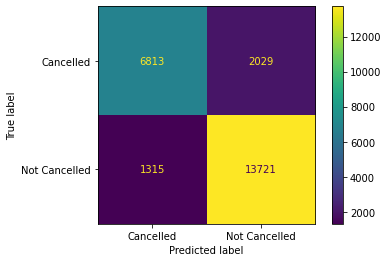

In [84]:
ConfusionMatrixDisplay(cm, display_labels = ['Cancelled', 'Not Cancelled']).plot();

#### ROCAUC

### Understanding the Model using ELI5

In [85]:
import eli5.sklearn

In [86]:
x_train = x_train.drop(['prediction'], axis = 1)
x_train = x_train.drop(['is_canceled'], axis = 1)
x_train = x_train.drop(['dataset'], axis = 1)

In [87]:
eli5.explain_weights( 
    xgb_classifier, 
    feature_names = x_train.columns.tolist())

Weight,Feature
0.5092,deposit_type_NonRefund
0.0486,is_alloted_same_room_type_0.0
0.0404,market_segment_OnlineTA
0.0350,required_car_parking_spaces
0.0271,deposit_type_NoDeposit
0.0215,country_PRT
0.0172,previous_cancellations
0.0144,customer_type_Transient
0.0135,total_of_special_requests
0.0105,market_segment_Direct


### Explaining the weights for a Non-Cancellation Person

In [88]:
eli5.explain_prediction( xgb_classifier,
                         x_test.iloc[10],
                         target_names = ['0', '1'] )

Explanation(estimator='XGBClassifier(max_depth=6, n_estimators=200)', description='\nFeatures with largest coefficients.\n\nFeature weights are calculated by following decision paths in trees\nof an ensemble. Each leaf has an output score, and expected scores can also be\nassigned to parent nodes. Contribution of one feature on the decision path\nis how much expected score changes from parent to child. Weights of all \nfeatures sum to the output score of the estimator.\n\nCaveats:\n1. Feature weights just show if the feature contributed positively or\n   negatively to the final score, and does not show how increasing or\n   decreasing the feature value will change the prediction.\n2. In some cases, feature weight can be close to zero for an important feature.\n   For example, in a single tree that computes XOR function, the feature at the\n   top of the tree will have zero weight because expected scores for both\n   branches are equal, so decision at the top feature does not change the\n   expected score. For an ensemble predicting XOR functions it might not be\n   a problem, but it is not reliable if most trees happen to choose the same\n   feature at the top.\n', error=None, method='decision paths', is_regression=False, targets=[TargetExplanation(target='0', feature_weights=FeatureWeights(pos=[FeatureWeight(feature='is_alloted_same_room_type_0.0', weight=1.2253209538171912, std=None, value=1.0), FeatureWeight(feature='country_PRT', weight=1.0836306214449458, std=None, value=0.0), FeatureWeight(feature='market_segment_OnlineTA', weight=0.755648511884949, std=None, value=0.0), FeatureWeight(feature='<BIAS>', weight=0.647584950380675, std=None, value=1.0), FeatureWeight(feature='market_segment_OfflineTA/TO', weight=0.4398471472912517, std=None, value=1.0), FeatureWeight(feature='deposit_type_NonRefund', weight=0.36979162425879336, std=None, value=0.0), FeatureWeight(feature='country_SWE', weight=0.31029062245234834, std=None, value=1.0), FeatureWeight(feature='customer_type_Transient', weight=0.24796482829109484, std=None, value=0.0), FeatureWeight(feature='booking_changes', weight=0.2275015361288868, std=None, value=2.0), FeatureWeight(feature='country_ITA', weight=0.21497661967470777, std=None, value=0.0), FeatureWeight(feature='arrival_date_month_September', weight=0.18625911995387687, std=None, value=1.0), FeatureWeight(feature='hotel_ResortHotel', weight=0.1614880864396297, std=None, value=0.0), FeatureWeight(feature='market_segment_Direct', weight=0.1483846410744965, std=None, value=0.0), FeatureWeight(feature='adr', weight=0.1428519246991055, std=None, value=74.0), FeatureWeight(feature='distribution_channel_TA/TO', weight=0.10127018280735293, std=None, value=1.0), FeatureWeight(feature='adults', weight=0.06635860554501993, std=None, value=1.0), FeatureWeight(feature='arrival_date_week_number_43.0', weight=0.04927656376409461, std=None, value=0.0), FeatureWeight(feature='arrival_date_month_May', weight=0.04505420117926458, std=None, value=0.0), FeatureWeight(feature='customer_type_Transient-Party', weight=0.0440537542251527, std=None, value=1.0), FeatureWeight(feature='arrival_date_week_number_27.0', weight=0.03787780109512978, std=None, value=0.0), FeatureWeight(feature='previous_cancellations', weight=0.03619881298123737, std=None, value=0.0), FeatureWeight(feature='arrival_date_week_number_15.0', weight=0.035203815441496845, std=None, value=0.0), FeatureWeight(feature='stays_in_week_nights', weight=0.03464517679542742, std=None, value=3.0), FeatureWeight(feature='deposit_type_NoDeposit', weight=0.027349812436125262, std=None, value=1.0), FeatureWeight(feature='arrival_date_month_October', weight=0.02658819939408691, std=None, value=0.0), FeatureWeight(feature='meal_SC', weight=0.020200594176682088, std=None, value=0.0), FeatureWeight(feature='country_ESP', weight=0.01542189801504176, std=None, value=0.0), FeatureWeight(feature='country_nan', weight=0.013782860717129962, std=None, value=0.0), FeatureWeight(feature='cou

### Explaining the weights for a Cancellation Person

In [100]:
eli5.explain_prediction( xgb_classifier,
                         x_test.iloc[212],
                         target_names = ['0', '1'] )

Explanation(estimator='XGBClassifier(max_depth=6, n_estimators=200)', description='\nFeatures with largest coefficients.\n\nFeature weights are calculated by following decision paths in trees\nof an ensemble. Each leaf has an output score, and expected scores can also be\nassigned to parent nodes. Contribution of one feature on the decision path\nis how much expected score changes from parent to child. Weights of all \nfeatures sum to the output score of the estimator.\n\nCaveats:\n1. Feature weights just show if the feature contributed positively or\n   negatively to the final score, and does not show how increasing or\n   decreasing the feature value will change the prediction.\n2. In some cases, feature weight can be close to zero for an important feature.\n   For example, in a single tree that computes XOR function, the feature at the\n   top of the tree will have zero weight because expected scores for both\n   branches are equal, so decision at the top feature does not change the\n   expected score. For an ensemble predicting XOR functions it might not be\n   a problem, but it is not reliable if most trees happen to choose the same\n   feature at the top.\n', error=None, method='decision paths', is_regression=False, targets=[TargetExplanation(target='1', feature_weights=FeatureWeights(pos=[FeatureWeight(feature='deposit_type_NonRefund', weight=4.713164866531585, std=None, value=1.0), FeatureWeight(feature='deposit_type_NoDeposit', weight=1.7332291180589228, std=None, value=0.0), FeatureWeight(feature='customer_type_Transient-Party', weight=0.5666033736066598, std=None, value=0.0), FeatureWeight(feature='customer_type_Transient', weight=0.2536011561612417, std=None, value=1.0), FeatureWeight(feature='country_PRT', weight=0.21618898662877323, std=None, value=1.0), FeatureWeight(feature='lead_time', weight=0.13003132947315132, std=None, value=184.0), FeatureWeight(feature='total_of_special_requests', weight=0.11718372820075729, std=None, value=0.0), FeatureWeight(feature='stays_in_week_nights', weight=0.058154991487790214, std=None, value=3.0), FeatureWeight(feature='market_segment_Groups', weight=0.050458620109765456, std=None, value=1.0), FeatureWeight(feature='arrival_date_month_May', weight=0.05006866753428463, std=None, value=1.0), FeatureWeight(feature='stays_in_weekend_nights', weight=0.04904131404135513, std=None, value=2.0), FeatureWeight(feature='booking_changes', weight=0.03663840600758508, std=None, value=0.0), FeatureWeight(feature='country_DEU', weight=0.03605505773628039, std=None, value=0.0), FeatureWeight(feature='arrival_date_month_July', weight=0.035953652689966045, std=None, value=0.0), FeatureWeight(feature='country_GBR', weight=0.025839886654521325, std=None, value=0.0), FeatureWeight(feature='country_FRA', weight=0.015995477633825646, std=None, value=0.0), FeatureWeight(feature='market_segment_OfflineTA/TO', weight=0.01344203155054957, std=None, value=0.0), FeatureWeight(feature='previous_bookings_not_canceled', weight=0.01148794028024779, std=None, value=0.0), FeatureWeight(feature='is_alloted_same_room_type_0.0', weight=0.009361903889002833, std=None, value=0.0), FeatureWeight(feature='market_segment_Direct', weight=0.009319922381153412, std=None, value=0.0), FeatureWeight(feature='country_BEL', weight=0.009250825138939291, std=None, value=0.0), FeatureWeight(feature='meal_Undefined', weight=0.008878275126193378, std=None, value=0.0), FeatureWeight(feature='arrival_date_month_June', weight=0.008798862716181216, std=None, value=0.0), FeatureWeight(feature='meal_HB', weight=0.007570886903933335, std=None, value=0.0), FeatureWeight(feature='country_IRL', weight=0.007293053640912146, std=None, value=0.0), FeatureWeight(feature='required_car_parking_spaces', weight=0.00724580133803622, std=None, value=0.0), FeatureWeight(feature='adr', weight=0.006714146674944038, std=None, value=130.0), FeatureWeight(feature='market_segment_Corporate', weight=0.006332250898929274, std=None, value=0.0), FeatureWeight(fea

### Partial Dependece Plots (PDPs)
- The effect of a feature on the outcome of an ML model after marginalizing the effect of other features
- Shows whether the relationship between the target and a feature is linear, monotonic or more complex.
- An assumption of the PDP is that the feature of interest (whose partial dependence is being computed) is not highly correlated with the other features. 

### Effect of Lead Time on Hotel Booking

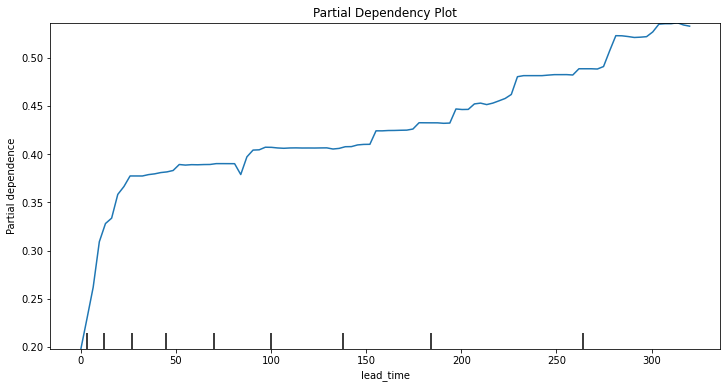

In [90]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.set_title("Partial Dependency Plot")
PartialDependenceDisplay.from_estimator(xgb_classifier,
                                        x_test,
                                        features = ['lead_time'],
                                        feature_names = x_train.columns.tolist(),
                                        ax = ax);


### Effect of Number of Adults on Hotel Booking

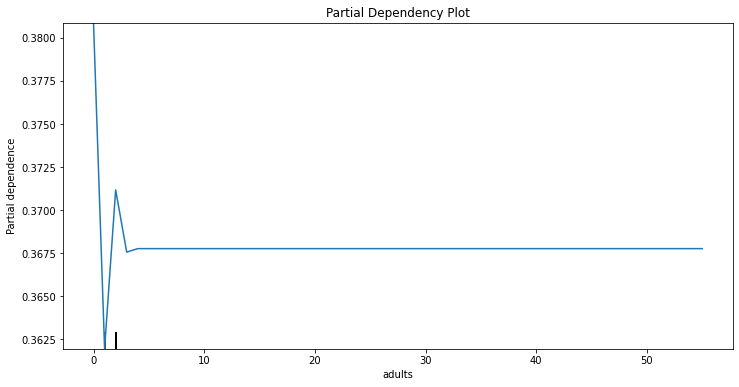

In [91]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.set_title("Partial Dependency Plot")
PartialDependenceDisplay.from_estimator(xgb_classifier,
                                        x_test,
                                        features = ['adults'],
                                        feature_names = x_train.columns.tolist(),
                                        ax = ax);

### LIME - Local Interpretation of Model Explanation


In [ ]:
!pip install lime

In [93]:
import lime
import lime.lime_tabular

Convert the dataframes into numpy type for further processing


In [94]:
x_train_mat = x_train.to_numpy()
y_train_mat = y_train.to_numpy()

xgb_classifier_matrix = xgb.XGBClassifier(**params)

xgb_classifier_matrix.fit(x_train_mat, 
                  y_train_mat)

XGBClassifier(max_depth=6, n_estimators=200)

In [95]:
x_test_mat = x_test.to_numpy()
y_test_mat = y_test.to_numpy()

In [96]:
explainer = (lime
             .lime_tabular
             .LimeTabularExplainer(training_data = x_train.to_numpy(), 
                                   training_labels = y_train,                                   
                                   feature_names = x_train.columns, 
                                   class_names = ['0', '1'],
                                   categorical_features = ['hotel_Resort Hotel'],
                                   categorical_names = ['hotel_Resort Hotel'], 
                                   kernel_width=3,
                                   verbose = True ))

### Explaining a case of No Cancellations

In [104]:
exp = explainer.explain_instance(x_test.iloc[10].to_numpy(), 
                                 xgb_classifier_matrix.predict_proba)

Intercept 2.041736459865121
Prediction_local [0.3184292]
Right: 0.002209878


In [105]:
exp.show_in_notebook(show_table=True, show_all=False)

### Explaining a case of Cancellation

In [106]:
exp = explainer.explain_instance(x_test.iloc[212].to_numpy(), 
                                 xgb_classifier_matrix.predict_proba)

Intercept 0.6162616838079008
Prediction_local [0.95950611]
Right: 0.99930954


In [107]:
exp.show_in_notebook(show_table=True, show_all=False)

### Subpart 2: Using Shapley Values

- Install SHAP

<code>
pip install shap
</code>

In [ ]:
!pip install shap

In [109]:
import shap

### Explaining a case of No Cancelation

In [110]:
row_to_show = 10
data_for_prediction = x_test.iloc[row_to_show]
data_for_prediction_array = data_for_prediction.values.reshape(1, -1)
xgb_classifier_matrix.predict_proba(data_for_prediction_array)

explainer = shap.TreeExplainer(xgb_classifier_matrix)
shap_values = explainer.shap_values(data_for_prediction_array)

shap.initjs()
shap.force_plot( explainer.expected_value, 
                 shap_values, 
                 data_for_prediction,
                 figsize=(20, 2) )

### Explaining a case of Cancelation

In [111]:
row_to_show = 212
data_for_prediction = x_test.iloc[row_to_show]
data_for_prediction_array = data_for_prediction.values.reshape(1, -1)
xgb_classifier_matrix.predict_proba(data_for_prediction_array)

shap_values = explainer.shap_values(data_for_prediction_array)

shap.initjs()
shap.force_plot( explainer.expected_value, 
                 shap_values, 
                 data_for_prediction,
                 figsize=(20, 2) )

### Global Explanation of SHAP

In [112]:
explainer = shap.TreeExplainer(xgb_classifier_matrix)
shap_values = explainer.shap_values(x_train)

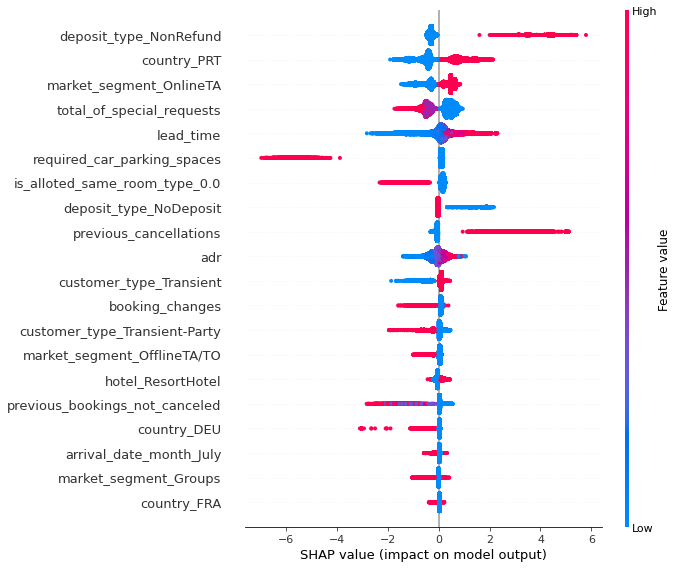

In [113]:
shap.summary_plot(shap_values, x_train, plot_type = 'dot')

### Individual Conditional Expectations (ICE)

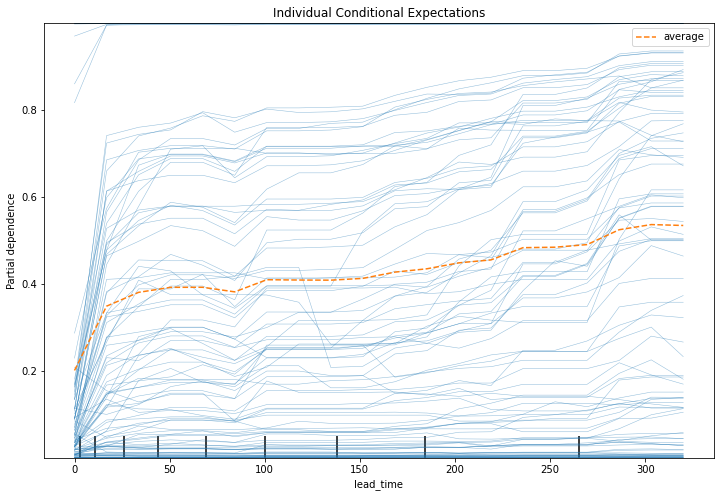

In [115]:
fig, ax = plt.subplots(figsize=(12, 8))
ax.set_title("Individual Conditional Expectations")

display = PartialDependenceDisplay.from_estimator(
    xgb_classifier,
    x_train,
    features=["lead_time"],
    kind="both",
    subsample=100,
    n_jobs=3,
    grid_resolution=20,
    random_state=0,
    ice_lines_kw={"color": "tab:blue", "alpha": 0.5, "linewidth": 0.5},
    pd_line_kw={"color": "tab:orange", "linestyle": "--"},
    ax = ax
)

## **Part C**: Creating Model Scorecard

In [ ]:
!pip install --upgrade pip==20.2
!pip install -U seaborn scikit-learn model-card-toolkit

In [117]:
from datetime import date
from io import BytesIO
from IPython import display
from sklearn.datasets import load_breast_cancer
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import plot_roc_curve, plot_confusion_matrix
import model_card_toolkit as mctlib

import base64
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import uuid

### Plot data

We will create several plots from the data that we will include in the model card.

In [118]:
# Utility function that will export a plot to a base-64 encoded string that the model card will accept.

def plot_to_str():
    img = BytesIO()
    plt.savefig(img, format='png')
    return base64.encodebytes(img.getvalue()).decode('utf-8')

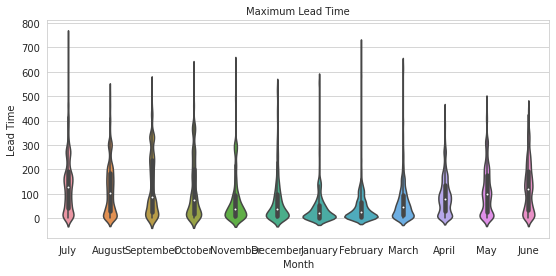

In [183]:
plt.figure(figsize = (9,4))
sns.set_style("whitegrid")
ax = sns.violinplot(x = 'arrival_date_month', y = 'lead_time' ,data= df_main)
ax.set_xlabel('Month', fontsize = 10)
ax.set_ylabel('Lead Time', fontsize = 10)
ax.set_title('Maximum Lead Time', fontsize = 10)
plt_lt = plot_to_str()

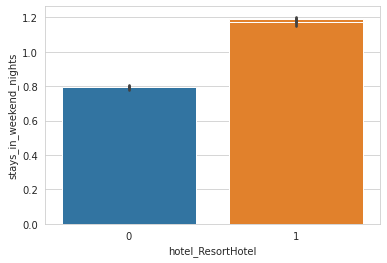

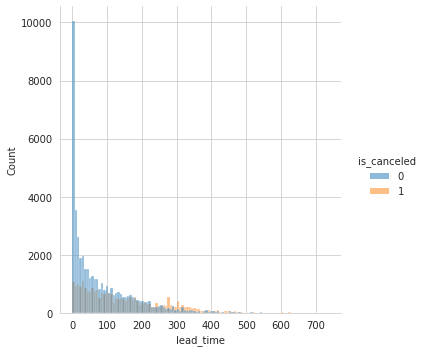

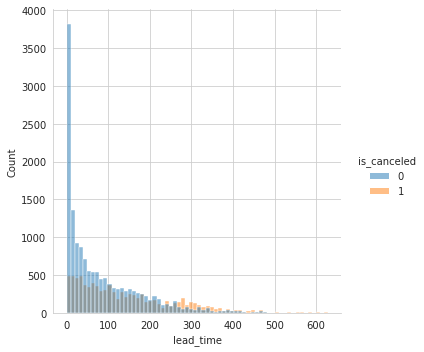

In [190]:
# Plot the mean radius feature for both the train and test sets


sns.barplot(x ='hotel_ResortHotel', y ='stays_in_weekend_nights', data = x_train)
mean_radius_train1 = plot_to_str()

sns.barplot(x ='hotel_ResortHotel', y ='stays_in_weekend_nights', data = x_test)
mean_radius_test1 = plot_to_str()

sns.displot(x=x_train['lead_time'], hue=y_train)
mean_radius_train2 = plot_to_str()

sns.displot(x=x_test['lead_time'], hue=y_test)
mean_radius_test2 = plot_to_str()

### Evaluate model

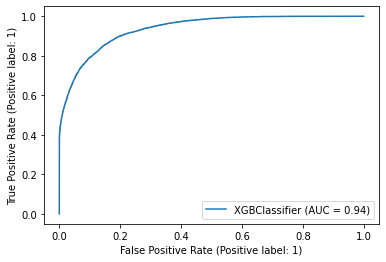

In [119]:
# Plot a ROC curve
plot_roc_curve(model_fit, x_test, y_test)
roc_curve = plot_to_str()

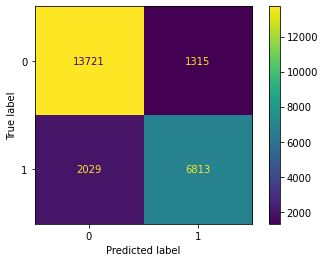

In [120]:
# Plot a confusion matrix

plot_confusion_matrix(model_fit, x_test, y_test)
confusion_matrix = plot_to_str()

### Create a model card

### Initialize toolkit and model card

In [196]:
mct = mctlib.ModelCardToolkit()
model_card = mct.scaffold_assets()

### Annotate model details into model card

In [197]:
model_card.model_details.name = 'Hotel Booking Dataset'
model_card.model_details.overview = (
    'This model predicts whether a person would cancel a hotel booking or not')
model_card.model_details.owners = [
    mctlib.Owner(name= 'Jesse Mostipak', contact='https://www.jessemaegan.com/')
]
model_card.model_details.references = [
    mctlib.Reference(reference='https://www.kaggle.com/jessemostipak/hotel-booking-demand')
]
model_card.model_details.version.name = str("Version 1.0")
model_card.model_details.version.date = str(date.today())

### Add model uses and user details, ethical considerations and limitations

In [198]:
model_card.considerations.ethical_considerations = [mctlib.Risk(
    name=('Personal data is being used for the analysis, so privacy concerns could be raised'),
    mitigation_strategy='Masking personal information and/or using encrypted values can help mitigate this issue'
)]
model_card.considerations.limitations = [mctlib.Limitation(description='This dataset covers only the North American region & might not be representative of the common use cases and concerns covering other regions & hotel booking systems.')]
model_card.considerations.use_cases = [mctlib.UseCase(description='Intended to be used for predicting probability of cancellation, understand contributing factors to bookings and develop mitigation strategies'), 
                                       mctlib.UseCase(description='Not intended to make judgements about sensitive segments of the society based on the cancellation predictions')]
model_card.considerations.users = [mctlib.User(description='Hotel and motel owners'), mctlib.User(description='ML researchers')]

### Add training and test dataset details

In [199]:
model_card.model_parameters.data.append(mctlib.Dataset(name="Training Dataset"))
model_card.model_parameters.data[0].graphics.description = (
  f'{len(x_train)} rows with {len(x_train.columns)} features')
model_card.model_parameters.data[0].graphics.collection = [
    mctlib.Graphic(image=mean_radius_train1),
    mctlib.Graphic(image=mean_radius_train2)
]


model_card.model_parameters.data.append(mctlib.Dataset(name="Test Dataset"))
model_card.model_parameters.data[1].graphics.description = (
  f'{len(x_test)} rows with {len(x_test.columns)} features')
model_card.model_parameters.data[1].graphics.collection = [
    mctlib.Graphic(image=mean_radius_test1),
    mctlib.Graphic(image=mean_radius_test2)
]

### Add Model Evaluation Details

In [200]:
model_card.quantitative_analysis.graphics.description = (
  'Understanding the data using general stats, ROC and AUC curves and Confusion Matrix')
model_card.quantitative_analysis.graphics.collection = [
    mctlib.Graphic(image=plt_lt),
    mctlib.Graphic(image=roc_curve),
    mctlib.Graphic(image=confusion_matrix)
]

In [201]:
mct.update_model_card(model_card)

### Generate model card

In [218]:
# Return the model card document as an HTML page

html = mct.export_format(output_file='mnt/model_cardv2.html')

In [222]:
Html_file= open("model_card_final.html","w")
Html_file.write(html)
Html_file.close()

In [216]:
display.display(display.HTML(html))